In [2]:
import spacy
import pandas as pd
releases = pd.read_csv('../data/releases_240522.csv')['content']
releases.head()

0    New Zealand is a step closer to a more resilie...
1    Education Minister Chris Hipkins and Associate...
2    The best way to have economic security in New ...
3    Whānau Ora Commissioning Agencies will receive...
4    The development of sustainable, plant-based fo...
Name: content, dtype: object

In [3]:
nlp = spacy.load('en_core_web_sm')
data =[]
for release in releases:
    doc = nlp(release)
    for sent in doc.sents:
        data.append(sent.text.strip())

In [3]:
data[:5]

['New Zealand is a step closer to a more resilient, competitive, and sustainable coastal shipping sector following the selection of preferred suppliers for new and enhanced coastal shipping services, Transport Minister Michael Wood has announced today.',
 '“Coastal shipping is a small but important part of the New Zealand freight system, which is why the Government is investing in making coastal shipping a more viable alternative to strengthen and diversify our domestic supply chain, helping to secure New Zealand’s recovery from COVID-19.',
 'As a lower emissions transport mode, investing in coastal shipping will also help us achieve our decarbonisation goals,” Michael Wood said.',
 'The Government has committed $30 million of funding for coastal shipping funding through the National Land Transport Programme (NLTP) to improve domestic shipping services, reduce emissions, improve efficiency and upgrade maritime infrastructure.',
 'Waka Kotahi worked with the wider freight industry (NZ S

In [4]:
len(data)

54041

In [1]:
from sentence_transformers import SentenceTransformer
model = SentenceTransformer('distilbert-base-nli-mean-tokens')

/usr/local/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/usr/local/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/usr/local/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/usr/local/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:519: FutureWarning: Passing (type, 1) or 

In [4]:
embeddings = model.encode(data, show_progress_bar=True)

Batches:   0%|          | 0/1689 [00:00<?, ?it/s]

In [ ]:
# pip install umap-learn

In [5]:
import umap
umap_embeddings = umap.UMAP(n_neighbors=15, 
                            n_components=5, 
                            metric='cosine').fit_transform(embeddings)

In [ ]:
# pip install hdbscan

In [6]:
import hdbscan
cluster = hdbscan.HDBSCAN(min_cluster_size=15,
                          metric='euclidean',                      
                          cluster_selection_method='eom').fit(umap_embeddings)

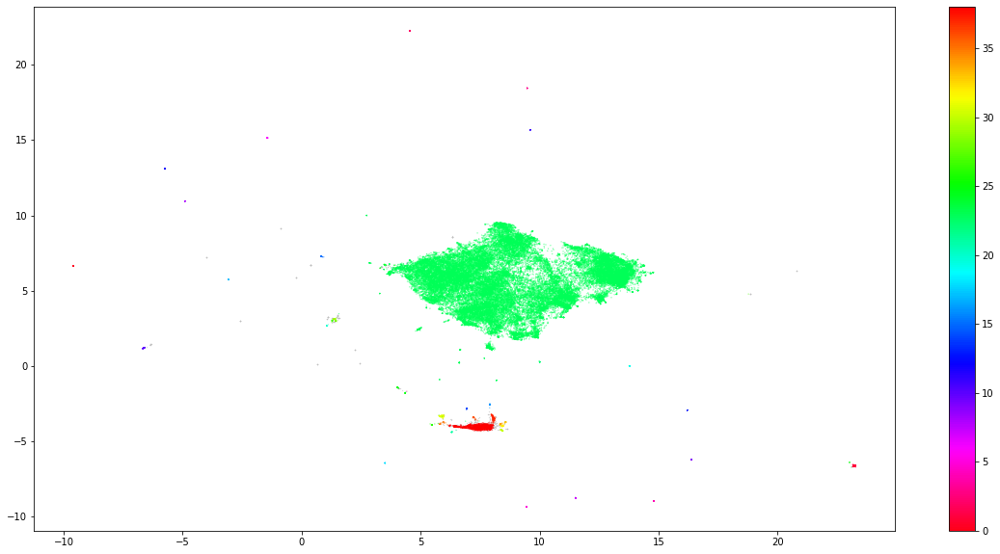

In [8]:
import matplotlib.pyplot as plt

# Prepare data
umap_data = umap.UMAP(n_neighbors=15, n_components=2, min_dist=0.0, metric='cosine').fit_transform(embeddings)
result = pd.DataFrame(umap_data, columns=['x', 'y'])
result['labels'] = cluster.labels_

# Visualize clusters
fig, ax = plt.subplots(figsize=(20, 10))
outliers = result.loc[result.labels == -1, :]
clustered = result.loc[result.labels != -1, :]
plt.scatter(outliers.x, outliers.y, color='#BDBDBD', s=0.05)
plt.scatter(clustered.x, clustered.y, c=clustered.labels, s=0.05, cmap='hsv_r')
plt.colorbar()
plt.show()

In [ ]:
# pip install bertopic

In [4]:
from bertopic import BERTopic

topic_model = BERTopic(language="english", calculate_probabilities=True, verbose=True)
topics, probs = topic_model.fit_transform(data)

Batches:   0%|          | 0/1689 [00:00<?, ?it/s]

2022-05-26 22:08:02,622 - BERTopic - Transformed documents to Embeddings
2022-05-26 22:09:21,670 - BERTopic - Reduced dimensionality
2022-05-26 22:34:55,814 - BERTopic - Clustered reduced embeddings


In [5]:
freq = topic_model.get_topic_info(); freq.head(10)

,Topic,Count,Name
0,-1,22887,-1_and_the_of_to
1,0,894,0_pandemic_covid19_virus_response
2,1,446,1_visa_visas_holders_immigration
3,2,372,2_awhi_plus_however_all
4,3,345,3_climate_change_shaw_james
5,4,336,4_covid19_zealanders_debt_position
6,5,336,5_challenge_but_we_do
7,6,329,6_mental_addiction_health_wellbeing
8,7,279,7_ng_te_whakataunga_ki
9,8,272,8_jobs_created_create_construction


In [6]:
representative_docs = topic_model.get_representative_docs()

In [8]:
lda_fig = topic_model.visualize_topics()
lda_fig.write_html("outputs/nz_release_lda_fig.html")
lda_fig

In [11]:
topic_model.visualize_distribution(probs[200], min_probability=0.001)

In [12]:
topic_model.visualize_hierarchy(top_n_topics=46)

In [13]:
topic_model.visualize_heatmap(n_clusters=20, width=1000, height=1000)

In [14]:
similar_topics, similarity = topic_model.find_topics("social distancing", top_n=5); similar_topics

[134, 417, 58, 527, 112]

In [15]:
topic_model.get_topic(134)

[('gatherings', 0.045010432568547275),
 ('distancing', 0.0432233149757663),
 ('physical', 0.028809465851279113),
 ('seated', 0.02650627044372021),
 ('mass', 0.019232117910392973),
 ('funerals', 0.016947580396558238),
 ('separated', 0.0164974957158115),
 ('hospitality', 0.014743660501637654),
 ('gathering', 0.013197996572649202),
 ('100', 0.0127312649690564)]

In [16]:
representative_docs[134]

['That means social distancing applies, and mass gatherings in that time will need to be limited to 100 people, as will all of the other guidance we are familiar with at level two.',
 'Today we are extending that advice to gatherings of 100 people indoors.',
 'We know being outdoors for gatherings is safe.']

In [17]:
topic_model.get_topic(417)

[('whistleblowers', 0.06473463258486765),
 ('disclosures', 0.05568239681870525),
 ('disclosure', 0.04507732590808756),
 ('privacy', 0.03733609099455438),
 ('protected', 0.03043721958825695),
 ('wrongdoing', 0.027743413964943283),
 ('act', 0.020984831867083782),
 ('disadvantages', 0.019611648247323633),
 ('noncrown', 0.017314166994154338),
 ('rights', 0.016689568154931944)]

In [18]:
representative_docs[417]

['“The Protected Disclosures (Protection of Whistleblowers) Act 2022 replaces the Protected Disclosures Act 2000.',
 'Significant improvements are being made in New Zealand workplaces to better protect whistleblowers, Minister for the Public Service Chris Hipkins said today.',
 'The new Protected Disclosures Act 2022 makes the disclosure process easier, extends and clarifies the grounds under which protected disclosures can be made and provides increased protection for whistleblowers.']